In [1]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np 
import seaborn as sns
from pandas_profiling import ProfileReport
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split , GridSearchCV
from sklearn.metrics  import accuracy_score, confusion_matrix , roc_auc_score , roc_curve

In [2]:
!python -V

Python 3.8.5


In [3]:
import sklearn 
sklearn.__version__

'0.23.2'

In [4]:
df=pd.read_csv('winequality-red.csv')

In [5]:
df

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5
1,7.8,0.880,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8,5
2,7.8,0.760,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8,5
3,11.2,0.280,0.56,1.9,0.075,17.0,60.0,0.99800,3.16,0.58,9.8,6
4,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5
...,...,...,...,...,...,...,...,...,...,...,...,...
1594,6.2,0.600,0.08,2.0,0.090,32.0,44.0,0.99490,3.45,0.58,10.5,5
1595,5.9,0.550,0.10,2.2,0.062,39.0,51.0,0.99512,3.52,0.76,11.2,6
1596,6.3,0.510,0.13,2.3,0.076,29.0,40.0,0.99574,3.42,0.75,11.0,6
1597,5.9,0.645,0.12,2.0,0.075,32.0,44.0,0.99547,3.57,0.71,10.2,5


In [6]:
df.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000
mean,8.319637,0.527821,0.270976,2.538806,0.087467,15.874922,46.467792,0.996747,3.311113,0.658149,10.422983,5.636023
std,1.741096,0.179060,0.194801,1.409928,0.047065,10.460157,32.895324,0.001887,0.154386,0.169507,1.065668,0.807569
min,4.600000,0.120000,0.000000,0.900000,0.012000,1.000000,6.000000,0.990070,2.740000,0.330000,8.400000,3.000000
25%,7.100000,0.390000,0.090000,1.900000,0.070000,7.000000,22.000000,0.995600,3.210000,0.550000,9.500000,5.000000
50%,7.900000,0.520000,0.260000,2.200000,0.079000,14.000000,38.000000,0.996750,3.310000,0.620000,10.200000,6.000000
75%,9.200000,0.640000,0.420000,2.600000,0.090000,21.000000,62.000000,0.997835,3.400000,0.730000,11.100000,6.000000
max,15.900000,1.580000,1.000000,15.500000,0.611000,72.000000,289.000000,1.003690,4.010000,2.000000,14.900000,8.000000


In [7]:
df.isnull().sum()

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64

In [8]:
ProfileReport(df)

<AxesSubplot:>

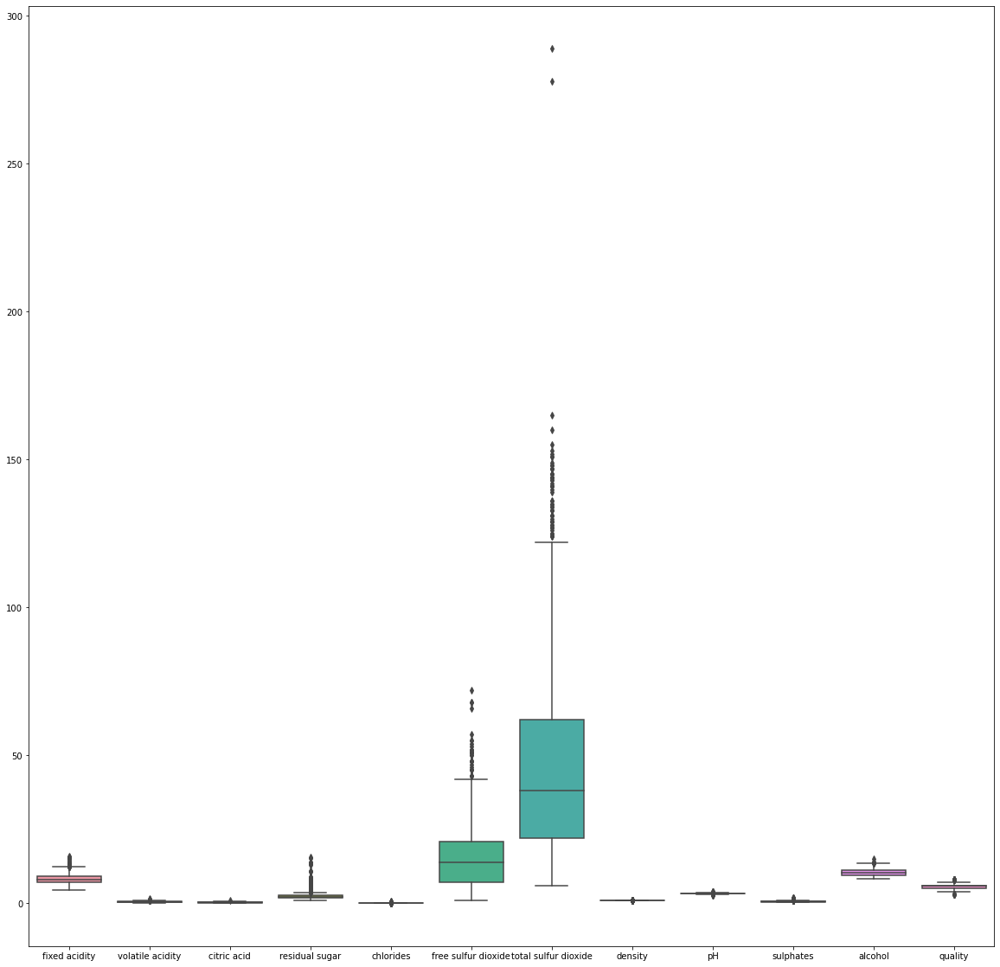

In [9]:
%matplotlib inline
fig,ax=plt.subplots(figsize=(20,20))
sns.boxplot(data=df , ax=ax)

In [10]:
# as citric values  have zero value we will be filling them by mean
#(Practically as a data analyst we will be consulting to wine expert that in wine making is citric acid an important element or not , can wines be made with no presence of citric acid and their take action. But for now we are filling it with mean value)
def TKPY_remove_zeros(df):
    for column in df.columns:
        print(df[column])
        df[column] = df[column].replace(0,df[column].mean())
TKPY_remove_zeros(df)

0        7.4
1        7.8
2        7.8
3       11.2
4        7.4
        ... 
1594     6.2
1595     5.9
1596     6.3
1597     5.9
1598     6.0
Name: fixed acidity, Length: 1599, dtype: float64
0       0.700
1       0.880
2       0.760
3       0.280
4       0.700
        ...  
1594    0.600
1595    0.550
1596    0.510
1597    0.645
1598    0.310
Name: volatile acidity, Length: 1599, dtype: float64
0       0.00
1       0.00
2       0.04
3       0.56
4       0.00
        ... 
1594    0.08
1595    0.10
1596    0.13
1597    0.12
1598    0.47
Name: citric acid, Length: 1599, dtype: float64
0       1.9
1       2.6
2       2.3
3       1.9
4       1.9
       ... 
1594    2.0
1595    2.2
1596    2.3
1597    2.0
1598    3.6
Name: residual sugar, Length: 1599, dtype: float64
0       0.076
1       0.098
2       0.092
3       0.075
4       0.076
        ...  
1594    0.090
1595    0.062
1596    0.076
1597    0.075
1598    0.067
Name: chlorides, Length: 1599, dtype: float64
0       11.0
1       25.0


In [11]:
ProfileReport(df)

In [12]:

q= df['total sulfur dioxide'].quantile(.98) 
df_new=df[df['total sulfur dioxide']<q]


<AxesSubplot:>

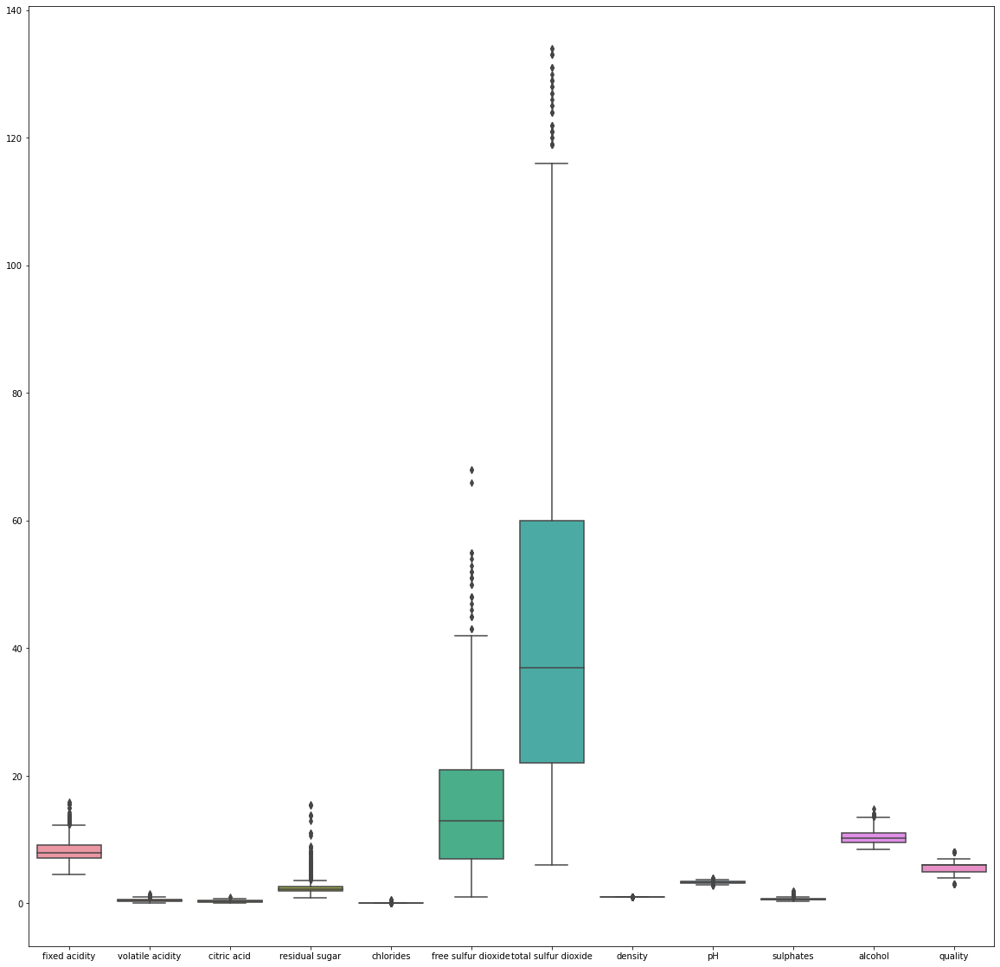

In [13]:
%matplotlib inline
fig,ax=plt.subplots(figsize=(20,20))
sns.boxplot(data=df_new , ax=ax)

In [14]:
y=df['quality']
x=df.drop(columns='quality')

In [15]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.10,random_state=200)


In [16]:
model=DecisionTreeClassifier()


In [17]:
model.fit(x_train,y_train) 

DecisionTreeClassifier()

In [18]:
model.predict(x_test)

array([7, 6, 5, 5, 6, 5, 6, 6, 5, 4, 5, 5, 6, 6, 5, 6, 5, 8, 5, 6, 7, 6,
       6, 6, 6, 7, 5, 6, 5, 5, 5, 6, 7, 7, 4, 6, 5, 5, 6, 5, 6, 8, 5, 5,
       4, 6, 5, 5, 5, 7, 5, 6, 5, 6, 6, 7, 5, 6, 6, 5, 5, 5, 6, 5, 6, 6,
       7, 7, 5, 6, 5, 6, 5, 5, 5, 4, 7, 5, 5, 6, 5, 5, 5, 6, 5, 6, 5, 6,
       5, 5, 5, 6, 5, 5, 6, 6, 7, 7, 7, 5, 5, 7, 6, 7, 4, 6, 6, 5, 5, 5,
       5, 5, 7, 5, 4, 6, 5, 6, 6, 5, 5, 7, 5, 6, 5, 4, 6, 5, 5, 5, 5, 5,
       5, 6, 6, 6, 5, 6, 5, 5, 6, 6, 6, 5, 6, 5, 5, 7, 6, 5, 5, 6, 5, 4,
       5, 5, 6, 5, 5, 6], dtype=int64)

In [19]:
x.shape

(1599, 11)

In [20]:
model.score(x_test,y_test)

0.65625

In [21]:
dt_en=DecisionTreeClassifier(criterion='entropy')
dt_en.fit(x_test,y_test) 
dt_en.score(x_test,y_test)


1.0

In [22]:
# to save the data on dot file and then see tree data
from sklearn import tree
outfile=dot_for_dt_en=open('dt_en_meta.dot','w')
tree.export_graphviz(dt_en,out_file=outfile,feature_names=x.columns)

Feature- continous& outcome - continous --->> regression


Feature- continous& outcome - categorical --->> classification


Feature- catergorical & outcome - categorical --->classification


as per the dataset we have different algorithm inside decision tree like ID3, C4.5 , CARTetc.

ID3 - Iterative dectomizer - used for classification problem i.e work on categorical attribute

C4.5 - similar to ID3 but the way it divide the dat into parent node , leaf node is little different used for classification problem 

CART- classsifcation and Regression tree so used for both ,generally we follow similar approch to this

In [23]:
import sklearn 
from sklearn import tree
%matplotlib inline

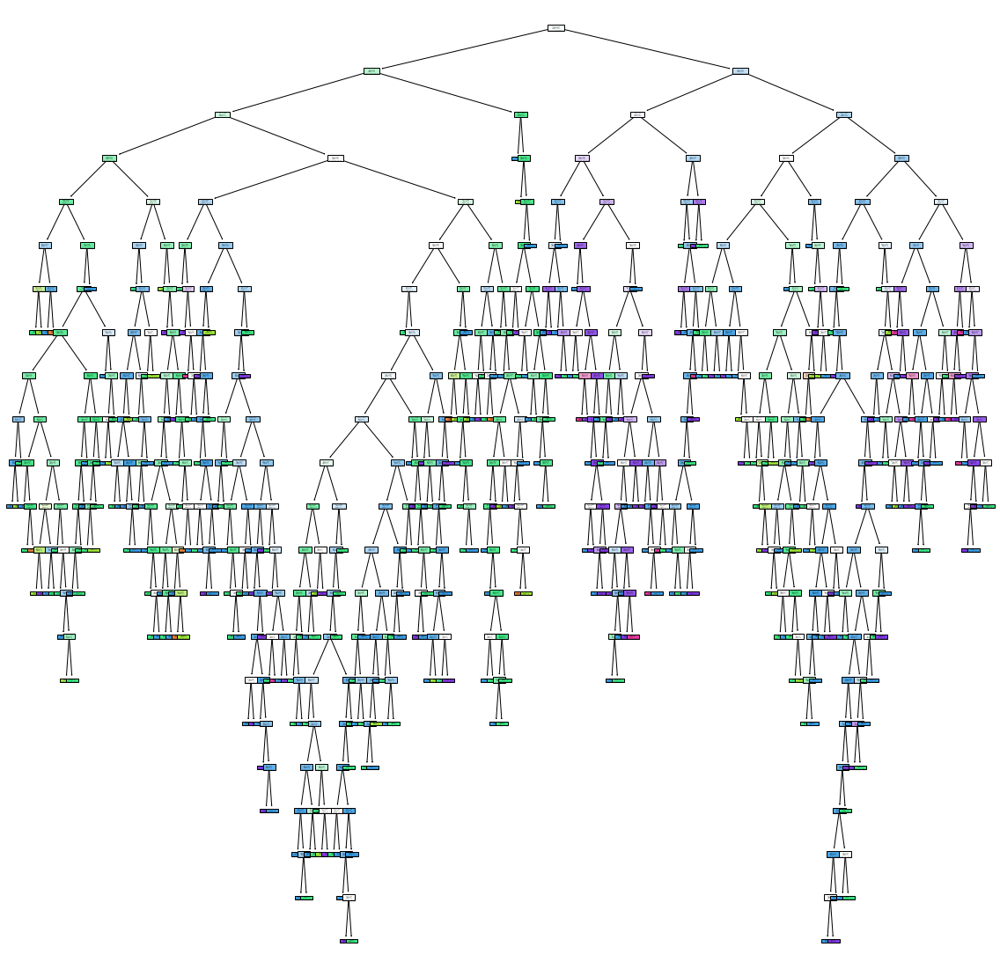

In [24]:
plt.figure(figsize=(20,20))
tree.plot_tree(model,filled=True)
plt.show()

In [25]:
df1=df.head(500)

In [26]:
x1=df1.drop(columns='quality')
y1=df1.quality
dt_model=DecisionTreeClassifier()
dt_model.fit(x1,y1)

DecisionTreeClassifier()

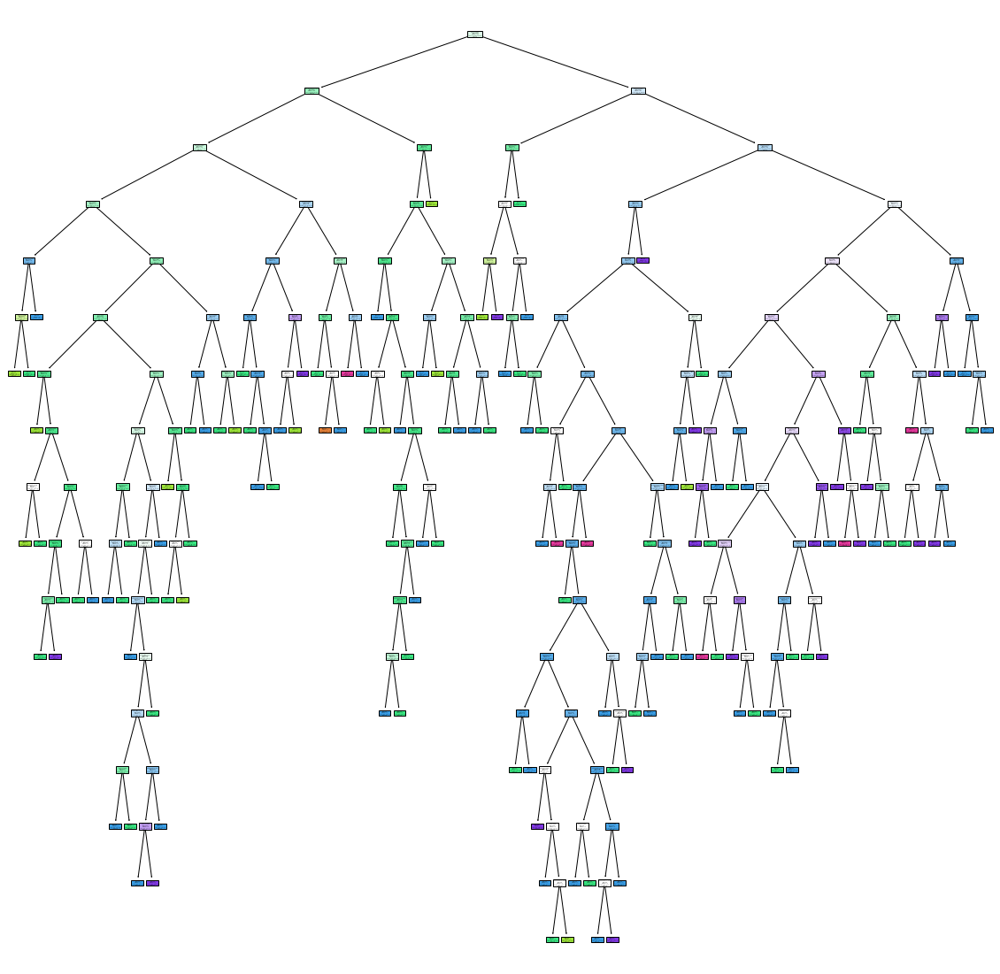

In [27]:
plt.figure(figsize=(20,20))
tree.plot_tree(dt_model,filled=True,class_names=[str(i) for i in set(y1)],feature_names=x1.columns) 
#classes converted into strings because class_names attribute only support strings so we convert numerical into string list
plt.show()

here in data if we can notice the last level of tree is unnecessary as it have 28 value of clas5 dn only 1 for class 6 for that splitting it is increasing the level of tree by 3 stages which increases the complexity of out model. 
So we can try doing post pruning and remove those 3 level it will dec accuracy by very min some percent but will have great advantage in time complexity which will be reduced(ccp_alpha is attribute used for cost complexity in a tree)

In [28]:
dt_model.predict(x1)

array([5, 5, 5, 6, 5, 5, 5, 7, 7, 5, 5, 5, 5, 5, 5, 5, 7, 5, 4, 6, 6, 5,
       5, 5, 6, 5, 5, 5, 5, 6, 5, 6, 5, 6, 5, 6, 6, 7, 4, 5, 5, 4, 6, 5,
       5, 4, 5, 5, 5, 5, 5, 6, 6, 5, 6, 5, 5, 5, 5, 6, 5, 5, 7, 5, 5, 5,
       5, 5, 5, 6, 6, 5, 5, 4, 5, 5, 5, 6, 5, 4, 5, 5, 5, 5, 6, 5, 6, 5,
       5, 5, 5, 6, 5, 5, 4, 6, 5, 5, 5, 6, 6, 6, 6, 5, 5, 5, 5, 5, 6, 5,
       5, 5, 5, 6, 5, 6, 6, 6, 6, 6, 5, 6, 5, 5, 5, 5, 5, 5, 7, 5, 5, 5,
       5, 6, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 5, 6, 6, 6, 4, 5, 5,
       5, 5, 5, 5, 5, 6, 5, 4, 6, 5, 5, 5, 5, 4, 6, 5, 4, 6, 6, 6, 5, 5,
       5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 6,
       7, 4, 7, 5, 5, 5, 6, 7, 7, 5, 5, 7, 6, 6, 6, 5, 6, 5, 5, 5, 5, 5,
       6, 5, 5, 6, 4, 6, 6, 5, 6, 5, 7, 6, 6, 5, 6, 6, 6, 6, 6, 6, 5, 6,
       6, 7, 7, 6, 5, 5, 6, 6, 6, 6, 5, 5, 6, 5, 5, 5, 5, 7, 5, 4, 5, 5,
       5, 7, 4, 8, 6, 6, 6, 6, 5, 5, 5, 6, 6, 6, 8, 7, 6, 7, 5, 7, 5, 5,
       6, 6, 7, 5, 7, 5, 6, 6, 6, 5, 5, 5, 5, 5, 6,

In [29]:
 dt_model.score(x1,y1) # can be consider as training accuracy as we didn't split the data for model

1.0

In [30]:
dt_model.predict(x_test) 
#trying to check for huge data which we used in above model give 50 as learning dataset which onl have 4 classes we can see in set(y1)
#but in x_test i.e actual data we have 6 classes but our model donn't know so predicted wrong

array([7, 6, 6, 4, 6, 5, 6, 6, 6, 6, 6, 6, 6, 6, 5, 6, 3, 7, 5, 6, 6, 5,
       6, 6, 5, 7, 8, 7, 6, 6, 5, 5, 6, 6, 6, 7, 5, 5, 5, 5, 6, 5, 5, 6,
       6, 5, 5, 6, 6, 8, 6, 7, 6, 7, 8, 7, 5, 6, 6, 5, 5, 5, 6, 5, 6, 8,
       7, 7, 6, 5, 6, 4, 6, 5, 5, 6, 6, 5, 5, 7, 6, 4, 6, 6, 4, 7, 6, 5,
       5, 6, 4, 6, 4, 8, 5, 5, 4, 8, 5, 5, 5, 7, 5, 7, 6, 6, 6, 6, 5, 5,
       5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 5, 8, 6, 5, 5, 6, 6, 5, 5, 6, 4, 5,
       6, 6, 5, 5, 5, 6, 6, 5, 6, 5, 6, 6, 4, 6, 7, 5, 5, 5, 5, 6, 5, 6,
       4, 5, 7, 6, 5, 5], dtype=int64)

In [31]:
dt_model.score(x_test,y_test) # because of above reason accuracy is less

0.575

In [32]:
  set(y1)

{3, 4, 5, 6, 7, 8}

In [33]:
# to save the tree graph
# plt.savefig('dt_model')

In [34]:
#post pruning
path=model.cost_complexity_pruning_path(x1,y1)
ccp_alpha=path.ccp_alphas

In [35]:
path

{'ccp_alphas': array([0.        , 0.00175   , 0.00181818, 0.00184615, 0.00185   ,
        0.00187879, 0.00188235, 0.0019    , 0.002     , 0.002     ,
        0.002     , 0.002     , 0.002     , 0.002     , 0.002     ,
        0.002     , 0.002     , 0.002     , 0.00261111, 0.00262769,
        0.00266667, 0.00266667, 0.00266667, 0.00266667, 0.00266667,
        0.00266667, 0.00266667, 0.00266667, 0.00272222, 0.00285714,
        0.003     , 0.003     , 0.003     , 0.003     , 0.00304762,
        0.00305051, 0.00308418, 0.00325   , 0.00328205, 0.00333333,
        0.00333333, 0.00334032, 0.00336606, 0.00342857, 0.00343316,
        0.0035    , 0.0035    , 0.0036    , 0.00363636, 0.00373333,
        0.00373809, 0.0038237 , 0.004     , 0.00404444, 0.00428571,
        0.00428571, 0.00437662, 0.00462338, 0.00465709, 0.00466667,
        0.0048    , 0.00487179, 0.00504242, 0.00508235, 0.00509091,
        0.00510606, 0.00516667, 0.00568485, 0.00589394, 0.00656364,
        0.00671079, 0.0067591 , 0.

In [36]:
ccp_alpha

array([0.        , 0.00175   , 0.00181818, 0.00184615, 0.00185   ,
       0.00187879, 0.00188235, 0.0019    , 0.002     , 0.002     ,
       0.002     , 0.002     , 0.002     , 0.002     , 0.002     ,
       0.002     , 0.002     , 0.002     , 0.00261111, 0.00262769,
       0.00266667, 0.00266667, 0.00266667, 0.00266667, 0.00266667,
       0.00266667, 0.00266667, 0.00266667, 0.00272222, 0.00285714,
       0.003     , 0.003     , 0.003     , 0.003     , 0.00304762,
       0.00305051, 0.00308418, 0.00325   , 0.00328205, 0.00333333,
       0.00333333, 0.00334032, 0.00336606, 0.00342857, 0.00343316,
       0.0035    , 0.0035    , 0.0036    , 0.00363636, 0.00373333,
       0.00373809, 0.0038237 , 0.004     , 0.00404444, 0.00428571,
       0.00428571, 0.00437662, 0.00462338, 0.00465709, 0.00466667,
       0.0048    , 0.00487179, 0.00504242, 0.00508235, 0.00509091,
       0.00510606, 0.00516667, 0.00568485, 0.00589394, 0.00656364,
       0.00671079, 0.0067591 , 0.00688352, 0.00688889, 0.007  

In [37]:
dt_model1=[]
for ccp in ccp_alpha:
    dt_m = DecisionTreeClassifier(ccp_alpha=ccp)
    dt_m.fit(x1,y1)
    dt_model1.append(dt_m)

In [38]:
dt_model1

[DecisionTreeClassifier(),
 DecisionTreeClassifier(ccp_alpha=0.00175),
 DecisionTreeClassifier(ccp_alpha=0.0018181818181818184),
 DecisionTreeClassifier(ccp_alpha=0.0018461538461538455),
 DecisionTreeClassifier(ccp_alpha=0.0018500000000000005),
 DecisionTreeClassifier(ccp_alpha=0.0018787878787878782),
 DecisionTreeClassifier(ccp_alpha=0.001882352941176471),
 DecisionTreeClassifier(ccp_alpha=0.0018999999999999996),
 DecisionTreeClassifier(ccp_alpha=0.002),
 DecisionTreeClassifier(ccp_alpha=0.002),
 DecisionTreeClassifier(ccp_alpha=0.002),
 DecisionTreeClassifier(ccp_alpha=0.002),
 DecisionTreeClassifier(ccp_alpha=0.002),
 DecisionTreeClassifier(ccp_alpha=0.002),
 DecisionTreeClassifier(ccp_alpha=0.002),
 DecisionTreeClassifier(ccp_alpha=0.002),
 DecisionTreeClassifier(ccp_alpha=0.002),
 DecisionTreeClassifier(ccp_alpha=0.002),
 DecisionTreeClassifier(ccp_alpha=0.0026111111111111114),
 DecisionTreeClassifier(ccp_alpha=0.0026276923076923083),
 DecisionTreeClassifier(ccp_alpha=0.0026666666

In [39]:
train_score=[i.score(x1,y1)for i in dt_model1]

In [40]:
test_score=[i.score(x_test,y_test)for i in dt_model1]

In [41]:
print(train_score)

[1.0, 0.998, 0.996, 0.992, 0.99, 0.986, 0.984, 0.98, 0.956, 0.956, 0.96, 0.954, 0.96, 0.956, 0.956, 0.958, 0.958, 0.958, 0.946, 0.942, 0.928, 0.926, 0.928, 0.926, 0.928, 0.926, 0.928, 0.928, 0.924, 0.922, 0.916, 0.908, 0.91, 0.914, 0.906, 0.91, 0.908, 0.904, 0.902, 0.896, 0.898, 0.898, 0.894, 0.89, 0.884, 0.884, 0.88, 0.882, 0.878, 0.878, 0.87, 0.866, 0.854, 0.854, 0.848, 0.846, 0.852, 0.838, 0.834, 0.818, 0.824, 0.81, 0.804, 0.802, 0.794, 0.79, 0.786, 0.784, 0.78, 0.776, 0.776, 0.772, 0.768, 0.762, 0.758, 0.742, 0.728, 0.718, 0.698, 0.69, 0.682, 0.676, 0.676, 0.636, 0.596, 0.596, 0.596, 0.558, 0.558]


In [42]:
print(test_score)

[0.5875, 0.56875, 0.59375, 0.575, 0.61875, 0.6, 0.59375, 0.575, 0.56875, 0.625, 0.5625, 0.5875, 0.5875, 0.58125, 0.575, 0.575, 0.6, 0.59375, 0.5875, 0.6375, 0.6, 0.6, 0.5875, 0.59375, 0.59375, 0.56875, 0.6, 0.6125, 0.6, 0.58125, 0.6125, 0.61875, 0.58125, 0.61875, 0.625, 0.6125, 0.56875, 0.55, 0.625, 0.64375, 0.6375, 0.63125, 0.64375, 0.60625, 0.63125, 0.63125, 0.625, 0.64375, 0.65, 0.65, 0.64375, 0.63125, 0.625, 0.65625, 0.6625, 0.65, 0.65, 0.64375, 0.625, 0.6375, 0.625, 0.61875, 0.64375, 0.65, 0.65, 0.65, 0.64375, 0.63125, 0.61875, 0.60625, 0.6, 0.59375, 0.5875, 0.60625, 0.59375, 0.60625, 0.6, 0.6, 0.6, 0.61875, 0.6125, 0.60625, 0.60625, 0.60625, 0.63125, 0.63125, 0.63125, 0.6125, 0.6125]


Through this we need to select the ccp value where test and train score is approx same their is not much huge diff

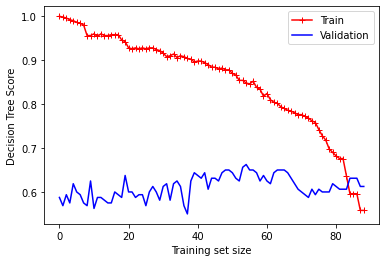

In [43]:
plt.plot(train_score,'r-+',label='Train')
plt.plot(test_score,'b-',label='Validation')
plt.xlabel('Training set size')
plt.ylabel('Decision Tree Score')
plt.legend()

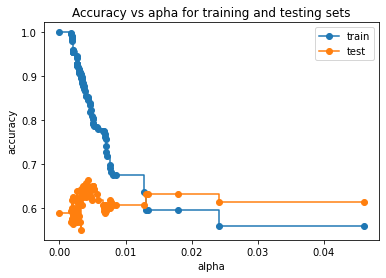

In [44]:
fix,ax=plt.subplots()
ax.set_xlabel("alpha")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs apha for training and testing sets")
ax.plot(ccp_alpha,train_score,marker='o',label="train",drawstyle="steps-post")
ax.plot(ccp_alpha,test_score,marker='o',label="test",drawstyle="steps-post")
ax.legend()
plt.show()

In [45]:
train_score

[1.0,
 0.998,
 0.996,
 0.992,
 0.99,
 0.986,
 0.984,
 0.98,
 0.956,
 0.956,
 0.96,
 0.954,
 0.96,
 0.956,
 0.956,
 0.958,
 0.958,
 0.958,
 0.946,
 0.942,
 0.928,
 0.926,
 0.928,
 0.926,
 0.928,
 0.926,
 0.928,
 0.928,
 0.924,
 0.922,
 0.916,
 0.908,
 0.91,
 0.914,
 0.906,
 0.91,
 0.908,
 0.904,
 0.902,
 0.896,
 0.898,
 0.898,
 0.894,
 0.89,
 0.884,
 0.884,
 0.88,
 0.882,
 0.878,
 0.878,
 0.87,
 0.866,
 0.854,
 0.854,
 0.848,
 0.846,
 0.852,
 0.838,
 0.834,
 0.818,
 0.824,
 0.81,
 0.804,
 0.802,
 0.794,
 0.79,
 0.786,
 0.784,
 0.78,
 0.776,
 0.776,
 0.772,
 0.768,
 0.762,
 0.758,
 0.742,
 0.728,
 0.718,
 0.698,
 0.69,
 0.682,
 0.676,
 0.676,
 0.636,
 0.596,
 0.596,
 0.596,
 0.558,
 0.558]

In [46]:
dt_model_ccp=DecisionTreeClassifier(random_state=0,ccp_alpha=0.014)
dt_model_ccp.fit(x1,y1)


DecisionTreeClassifier(ccp_alpha=0.014, random_state=0)

In [47]:
dt_model_ccp.score(x1,y1)

0.596

In [48]:
dt_model_ccp.score(x_test,y_test)

0.63125

### After prunning using ccp alpha we get approx saem score for training and testing score so we can say that our model is efficient now

[Text(558.0, 906.0, 'X[10] <= 9.85\ngini = 0.624\nsamples = 500\nvalue = [1, 16, 239, 184, 52, 8]'),
 Text(279.0, 543.6, 'X[6] <= 62.5\ngini = 0.504\nsamples = 259\nvalue = [1, 12, 167, 72, 6, 1]'),
 Text(139.5, 181.19999999999993, 'gini = 0.576\nsamples = 169\nvalue = [1, 9, 91, 61, 6, 1]'),
 Text(418.5, 181.19999999999993, 'gini = 0.271\nsamples = 90\nvalue = [0, 3, 76, 11, 0, 0]'),
 Text(837.0, 543.6, 'X[9] <= 0.545\ngini = 0.657\nsamples = 241\nvalue = [0, 4, 72, 112, 46, 7]'),
 Text(697.5, 181.19999999999993, 'gini = 0.408\nsamples = 32\nvalue = [0, 2, 24, 5, 1, 0]'),
 Text(976.5, 181.19999999999993, 'gini = 0.638\nsamples = 209\nvalue = [0, 2, 48, 107, 45, 7]')]

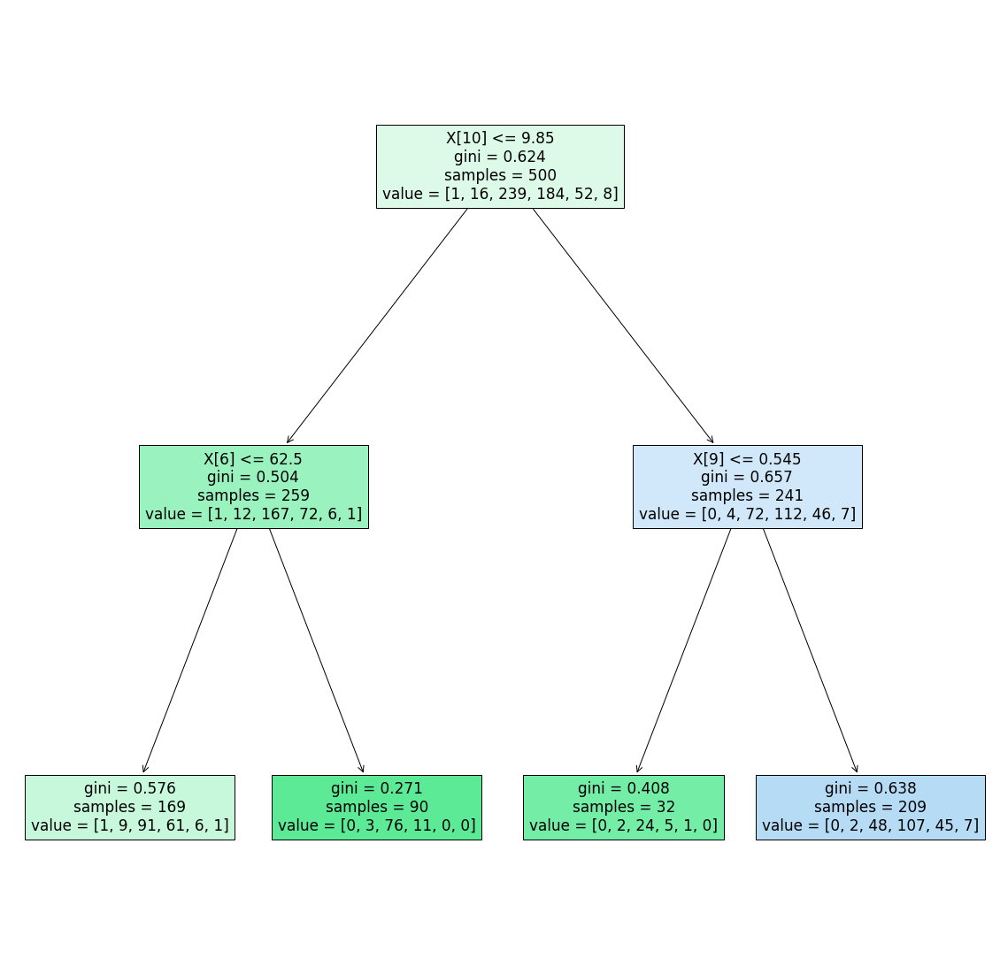

In [49]:
plt.figure(figsize=(20,20))
tree.plot_tree(dt_model_ccp,filled=True)

In [50]:
DecisionTreeClassifier()
grid_pram={"criterion":['gini','entropy'],
          "splitter":['best','random'],
          "max_depth":range(2,40,1),
          "min_samples_split":range(2,10,1),
          "min_samples_leaf":range(1,10,1)}

In [51]:
grid_ccp=GridSearchCV(estimator=dt_model_ccp,param_grid=grid_pram,cv=5,n_jobs=-1) # -1 in n_jobs means occupy all the process in cpu , if we inc like -4 then it will not execute all the  rocess as it will slow down processing speed

In [52]:
grid_ccp.fit(x1,y1)

C:\Users\Sandeep\anaconda3\lib\site-packages\sklearn\model_selection\_split.py:670: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(("The least populated class in y has only %d"


GridSearchCV(cv=5,
             estimator=DecisionTreeClassifier(ccp_alpha=0.014, random_state=0),
             n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': range(2, 40),
                         'min_samples_leaf': range(1, 10),
                         'min_samples_split': range(2, 10),
                         'splitter': ['best', 'random']})

In [53]:
grid_ccp.best_params_

{'criterion': 'entropy',
 'max_depth': 4,
 'min_samples_leaf': 4,
 'min_samples_split': 9,
 'splitter': 'random'}

In [54]:
3# yper parmeter tuning
dt_ccp_new=DecisionTreeClassifier(criterion='entropy',max_depth=4,ccp_alpha=0.014,min_samples_leaf=4,min_samples_split=9,splitter='random')

In [55]:
dt_ccp_new.fit(x1,y1)

DecisionTreeClassifier(ccp_alpha=0.014, criterion='entropy', max_depth=4,
                       min_samples_leaf=4, min_samples_split=9,
                       splitter='random')

In [56]:
dt_ccp_new.score(x1,y1)

0.592

In [57]:
dt_ccp_new.score(x_test,y_test)

0.55

done hyper parameter tuning but still having over fitting 

In [58]:
pred =dt_ccp_new.predict(x_train)

In [59]:
confusion_matrix(y_train,pred)

array([[  0,   0,   6,   4,   0,   0],
       [  0,   2,  22,  21,   0,   0],
       [  0,   5, 429, 173,   1,   0],
       [  0,   6, 242, 317,  11,   0],
       [  0,   0,  34, 144,   5,   0],
       [  0,   0,   6,  11,   0,   0]], dtype=int64)

In [60]:
X=df.drop(columns=['quality'])

In [61]:
Y=df.quality

In [62]:
from sklearn.ensemble import BaggingClassifier

In [63]:
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,random_state=0) # by default split size is 75 25

In [64]:
bag_dt=BaggingClassifier(DecisionTreeClassifier(),n_estimators=10)

In [65]:
bag_dt.fit(X_train,Y_train)

BaggingClassifier(base_estimator=DecisionTreeClassifier())

In [66]:
bag_dt.predict(X_test)

array([5, 5, 7, 5, 5, 6, 5, 6, 5, 5, 5, 5, 6, 4, 5, 7, 7, 5, 6, 6, 6, 5,
       6, 6, 5, 5, 5, 7, 5, 6, 5, 7, 6, 5, 7, 7, 5, 5, 6, 6, 6, 6, 7, 7,
       6, 5, 5, 6, 5, 6, 5, 5, 6, 6, 6, 5, 5, 5, 7, 5, 5, 6, 6, 6, 5, 6,
       5, 5, 7, 6, 5, 5, 5, 5, 6, 6, 5, 5, 5, 6, 6, 5, 7, 6, 6, 6, 6, 5,
       5, 5, 5, 5, 6, 5, 6, 5, 7, 5, 5, 5, 7, 6, 6, 6, 5, 5, 5, 6, 6, 5,
       6, 5, 6, 6, 6, 6, 6, 7, 7, 6, 5, 6, 5, 5, 6, 6, 5, 5, 5, 6, 5, 6,
       6, 6, 6, 5, 6, 5, 6, 5, 6, 5, 5, 5, 5, 6, 6, 6, 6, 5, 6, 7, 6, 6,
       6, 6, 5, 6, 6, 5, 6, 6, 7, 5, 5, 5, 6, 6, 6, 6, 6, 5, 6, 7, 4, 6,
       7, 7, 7, 5, 5, 8, 6, 7, 7, 5, 6, 6, 5, 6, 6, 6, 6, 6, 5, 5, 5, 6,
       6, 5, 5, 6, 6, 6, 5, 5, 5, 6, 7, 6, 6, 6, 5, 6, 5, 6, 5, 7, 6, 5,
       5, 6, 6, 5, 6, 6, 6, 6, 6, 6, 5, 6, 5, 5, 6, 6, 6, 7, 7, 6, 5, 6,
       5, 5, 6, 5, 5, 5, 5, 7, 5, 5, 5, 6, 5, 5, 5, 5, 5, 7, 6, 6, 6, 6,
       5, 5, 5, 5, 5, 6, 6, 7, 6, 6, 6, 6, 6, 6, 6, 5, 5, 6, 7, 6, 6, 5,
       5, 5, 7, 6, 5, 5, 6, 6, 5, 6, 6, 6, 6, 5, 6,

In [67]:
bag_dt.base_estimator_

DecisionTreeClassifier()

In [68]:
from sklearn.neighbors import KNeighborsClassifier 
bag_knn=BaggingClassifier(KNeighborsClassifier(),n_estimators=10)

In [69]:
bag_knn.fit(X_train,Y_train)

BaggingClassifier(base_estimator=KNeighborsClassifier())

In [70]:
bag_knn.predict(X_test)

array([5, 6, 7, 6, 6, 6, 6, 6, 6, 6, 5, 6, 5, 5, 5, 5, 7, 6, 7, 5, 6, 6,
       6, 5, 6, 5, 5, 6, 5, 6, 6, 6, 5, 6, 6, 6, 5, 6, 6, 6, 5, 7, 6, 5,
       6, 6, 5, 6, 5, 6, 6, 5, 6, 6, 5, 5, 5, 5, 5, 5, 5, 6, 6, 5, 5, 5,
       5, 7, 8, 7, 5, 5, 6, 5, 6, 6, 5, 5, 5, 6, 5, 5, 5, 6, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 5, 7, 5, 6, 6, 5, 6, 5, 6, 6, 5,
       6, 5, 6, 6, 5, 7, 5, 7, 7, 6, 5, 7, 6, 5, 7, 5, 5, 5, 5, 6, 5, 5,
       5, 5, 6, 5, 6, 5, 6, 5, 6, 5, 5, 5, 5, 6, 6, 7, 5, 6, 6, 5, 6, 6,
       6, 6, 6, 6, 6, 6, 6, 6, 5, 6, 6, 5, 6, 5, 6, 5, 5, 7, 6, 7, 7, 6,
       5, 7, 6, 5, 5, 6, 6, 6, 7, 5, 6, 6, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5,
       5, 5, 6, 6, 6, 6, 5, 5, 6, 6, 6, 5, 5, 5, 5, 5, 5, 6, 5, 6, 6, 5,
       5, 5, 6, 7, 6, 6, 5, 5, 6, 5, 5, 6, 5, 7, 7, 6, 7, 6, 7, 7, 6, 6,
       6, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 5, 6, 5, 6, 5, 6, 5, 5,
       5, 5, 6, 5, 6, 5, 5, 5, 6, 5, 6, 6, 5, 6, 6, 7, 6, 6, 5, 5, 5, 5,
       5, 5, 6, 6, 5, 5, 6, 6, 5, 6, 5, 5, 5, 5, 7,

In [71]:
from sklearn.ensemble import RandomForestClassifier

In [72]:
rf=RandomForestClassifier(n_estimators=5)

In [73]:
rf.fit(X_train,Y_train)

RandomForestClassifier(n_estimators=5)

In [74]:
rf.score(X_test,Y_test)

0.645

In [75]:
bag_dt.score(X_test,Y_test)

0.63

In [76]:
bag_knn.score(X_test,Y_test)

0.52

In [77]:
rf.estimators_

[DecisionTreeClassifier(max_features='auto', random_state=869760979),
 DecisionTreeClassifier(max_features='auto', random_state=1103496516),
 DecisionTreeClassifier(max_features='auto', random_state=1241572770),
 DecisionTreeClassifier(max_features='auto', random_state=917509526),
 DecisionTreeClassifier(max_features='auto', random_state=1122154759)]

In [78]:
# import pickle as pkl 
# file='DT.sav'
# pkl.dump(bag_dt,open(file,'wb'))

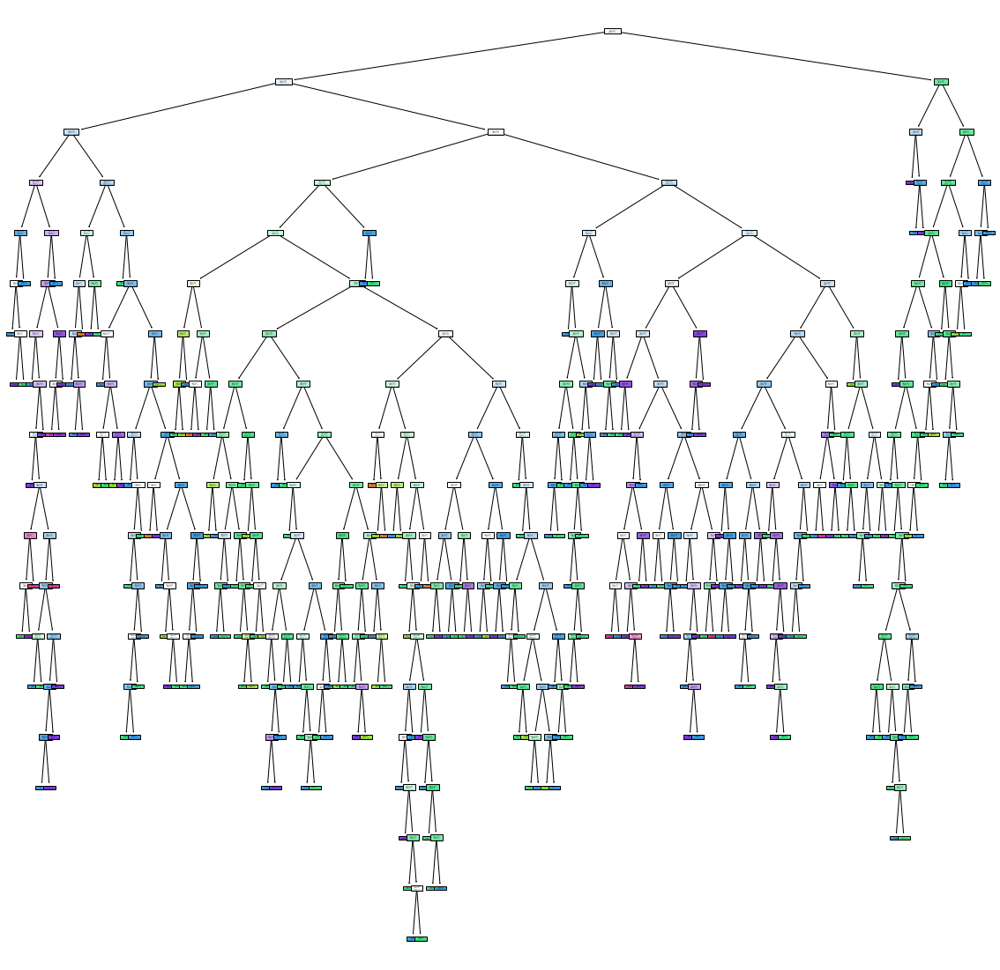

In [79]:
plt.figure(figsize=(20,20))
tree.plot_tree(rf.estimators_[0],filled=True)
plt.show() 

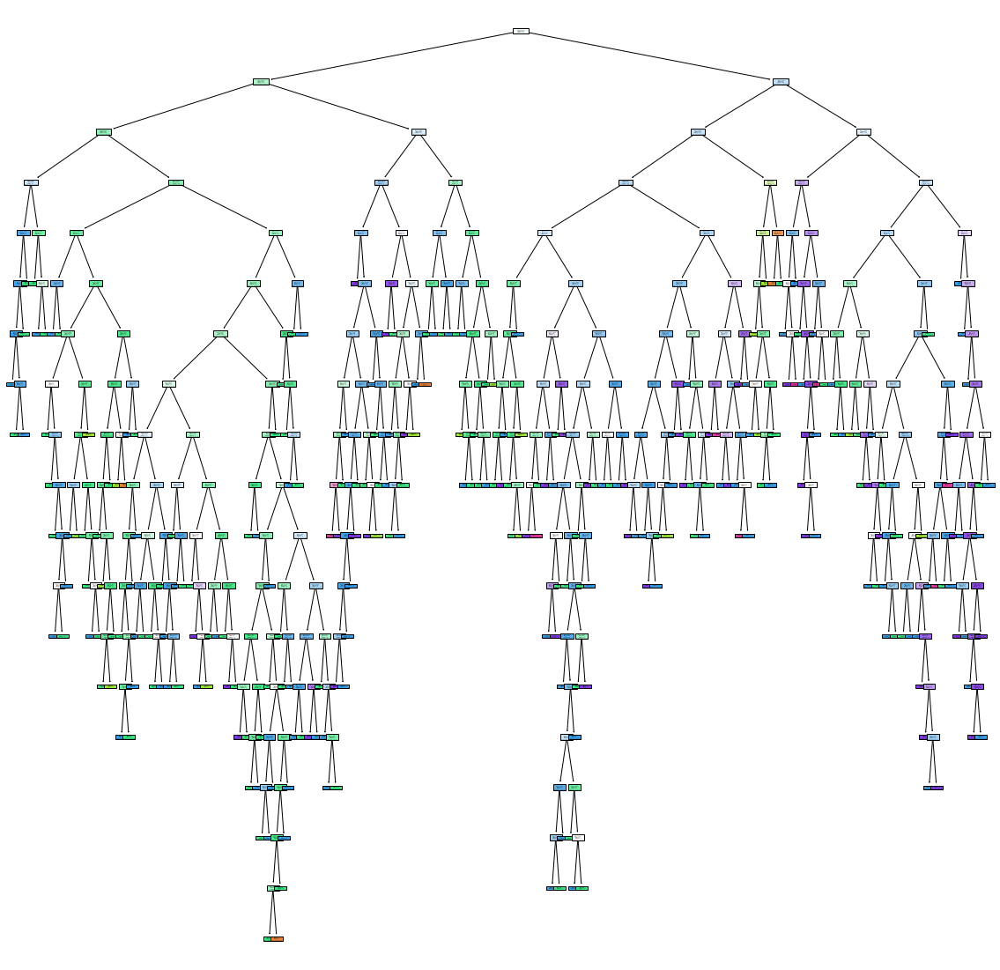

In [80]:
plt.figure(figsize=(20,20))
for i in range(len(rf.estimators_)):
    tree.plot_tree(rf.estimators_[i],filled=True)


In [81]:
grid_pram={"n_estimators":[5,10,50,100,120],
          'criterion':['gini','entropy'],
          'max_depth':range(10),
          'min_samples_leaf':range(10)}

In [82]:
rf1=RandomForestClassifier(n_estimators=5)

In [83]:
grid_search_rf=GridSearchCV(param_grid=grid_pram,cv=10,n_jobs=6,estimator=rf)

In [84]:
grid_search_rf.fit(X_train,Y_train)

C:\Users\Sandeep\anaconda3\lib\site-packages\sklearn\model_selection\_split.py:670: UserWarning: The least populated class in y has only 8 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


GridSearchCV(cv=10, estimator=RandomForestClassifier(n_estimators=5), n_jobs=6,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': range(0, 10),
                         'min_samples_leaf': range(0, 10),
                         'n_estimators': [5, 10, 50, 100, 120]})

In [85]:
grid_search_rf.score(X_test,Y_test)

0.685

In [86]:
grid_search_rf.best_params_

{'criterion': 'entropy',
 'max_depth': 9,
 'min_samples_leaf': 1,
 'n_estimators': 100}

In [87]:
 Best_rf=RandomForestClassifier(criterion='entropy',
 max_depth=9,
 min_samples_leaf=1,
 n_estimators=120)

In [88]:
Best_rf.fit(X_train,Y_train)

RandomForestClassifier(criterion='entropy', max_depth=9, n_estimators=120)

In [89]:
Best_rf.score(X_test,Y_test)

0.7

In [90]:
pr=Best_rf.predict(X_test)

#### Hence, we can't say the doing hyperparametering increaes accuracy of a model, It may inc stability of model but we can't comment on accuracy it can dec and inc either ways

In [92]:
confusion_matrix(Y_test,pr)

array([[  0,   0,   0,   2,   0,   0],
       [  0,   0,  10,   4,   0,   0],
       [  0,   0, 135,  32,   2,   0],
       [  0,   0,  36, 121,  13,   0],
       [  0,   0,   2,  14,  24,   0],
       [  0,   0,   0,   2,   3,   0]], dtype=int64)